#1. Import


In [138]:
!pip install owslib
!pip install pyproj
!pip install geojson
!pip install ratelimit
!pip install diskcache
!pip install tqdm
!pip install selenium
!pip install -U branca
!pip install python-dotenv


In [103]:
from owslib.wfs import WebFeatureService
import geopandas as gpd
import requests
from geopy.geocoders import Nominatim
from geopy.exc import GeocoderTimedOut
import folium
from branca.colormap import LinearColormap
import pyproj
import pandas as pd
from functools import partial
from functools import lru_cache
import pickle
import numpy as np
from pyproj import Transformer
import pickle
import inspect
from ratelimit import limits, sleep_and_retry
import geojson
import pandas as pd
import folium
from folium import plugins
from branca.colormap import LinearColormap
from tqdm.notebook import tqdm
import time
from folium.plugins import HeatMap
import matplotlib.pyplot as plt
from diskcache import Cache
from google.colab import drive
from shapely.geometry import Polygon, MultiPolygon, Point
import io
import base64
from selenium import webdriver
from PIL import Image
import datetime
from scipy.spatial.distance import cdist
import os
from dotenv import load_dotenv



## Set up cache directory in drive. otherwise figure out where to save your cache

In [3]:
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [4]:

cache=Cache("/content/drive/MyDrive/IH/cachedir",size_limit=10**9)

##Load API KEY, (UNTESTED)



In [ ]:
# Load environment variables from .env file
load_dotenv()

# Access the API key
api_key = os.getenv("TRAVELTIME_API_KEY")

# Now you can use the api_key variable in your code where needed
print(api_key)  # This line is for testing

#2. Functions


##add point to map

In [21]:
def add_point_to_map(map_object, latitude, longitude, popup_text=None, **kwargs):
    """
    Adds a point (CircleMarker) to a Folium map.

    Args:
        map_object (folium.Map): The Folium map object to add the point to.
        latitude (float): Latitude of the point.
        longitude (float): Longitude of the point.
        popup_text (str, optional): Text to display in a popup when the point is clicked. Defaults to None.
        **kwargs: Additional keyword arguments to pass to folium.CircleMarker.
    """
    folium.CircleMarker(
        location=[latitude, longitude],
        radius=5,  # Default radius, can be overridden with kwargs
        color='blue',  # Default color, can be overridden with kwargs
        fill=True,
        fill_color='blue',  # Default fill color, can be overridden with kwargs
        popup=popup_text,
        **kwargs  # Allows customization of other marker properties
    ).add_to(map_object)


##get berlin pop density

In [22]:
@cache.memoize()
def get_berlin_population_density():
    # Connect to the WFS service
    url = 'https://gdi.berlin.de/services/wfs/ua_einwohnerdichte_2023'
    wfs = WebFeatureService(url=url, version='2.0.0')

    # Request the population density layer
    layer_name = 'ua_einwohnerdichte_2023:einwohnerdichte2023'

    # Get the feature data
    response = wfs.getfeature(
        typename=layer_name,
        outputFormat='application/json'  # Request GeoJSON format
    )

    # Convert to GeoDataFrame
    gdf = gpd.read_file(response)

    print(f"Data loaded successfully with {len(gdf)} features")
    print("Available columns:", gdf.columns)

    return gdf

def create_population_density_map(gdf):
    # Create base map centered on Berlin
    m = folium.Map(location=[52.5200, 13.4050], zoom_start=11)

    # Create a custom colormap
    colormap = LinearColormap(
        colors=['#fff7ec', '#fee8c8', '#fdd49e', '#fdbb84', '#fc8d59', '#ef6548', '#d7301f', '#990000'],
        vmin=gdf['ew2023'].min(),
        vmax=gdf['ew2023'].max(),
        caption='Inhabitants 2023'  # Legend title
    )

    # Add the choropleth layer
    folium.GeoJson(
        gdf,
        name='Population',
        style_function=lambda feature: {
            'fillColor': colormap(feature['properties']['ew2023']),
            'color': 'none',
            'weight': 1,
            'fillOpacity': 1
        },
        tooltip=folium.GeoJsonTooltip(
            fields=['ew2023'],
            aliases=['Population:'],
            localize=True
        )
    ).add_to(m)

    # Add the colormap to the map
    colormap.add_to(m)

    # Add layer control
    folium.LayerControl().add_to(m)

    return m

##get coordinates

In [23]:
@cache.memoize()
def get_coordinates(address):
    """
    Convert an address string to latitude and longitude coordinates using geocoding

    Parameters:
    address (str): Address to geocode (e.g. "1600 Pennsylvania Ave NW, Washington, DC")

    Returns:
    tuple: (latitude, longitude) coordinates, or None if geocoding fails
    """
    # Initialize the geocoder
    geolocator = Nominatim(user_agent="my_application")

    try:
        # Attempt to geocode the address
        location = geolocator.geocode(address)

        if location:
            # Return coordinates as (latitude, longitude)
            return (location.latitude, location.longitude)
        else:
            print(f"Could not find coordinates for address: {address}")
            return None

    except Exception as e:
        # Handle any geocoding errors
        print(f"Error geocoding address: {str(e)}")
        return None


##generating isochrone

In [24]:


def generate_shape(latlongtuple):
  latitude= latlongtuple[0]
  longitude=latlongtuple[1]
  """
    Generate an isochrone shape for given coordinates using the TravelTime API

    Parameters:
    longitude (float): Longitude of the center point
    latitude (float): Latitude of the center point

    Returns:
  list: List of coordinate pairs forming the isochrone shape
    """
    # Set up the request headers with API credentials
  headers = {
        'Content-Type': 'application/json',
        'X-Application-Id': '9d4ab495',
        'X-Api-Key': 'cbe7073750cb32990fc0e4fd327a1ce0',
        'Host': 'api.traveltimeapp.com'
    }

    # Configure the request body with search parameters
    # - Sets origin coordinates
    # - Sets 30 min (1800 sec) travel time limit
    # - Uses public transport as travel mode
    # - Sets departure time in the future
  body = {
        "departure_searches": [
            {
                "id": "isochrone-0",
                "coords": {
                    "lng": longitude,
                    "lat": latitude
                },
                "travel_time": 900,
                "no_holes":True,
                "snapping":True,
                "transportation": {
                    "type": "public_transport"
                },
                "departure_time": "2025-03-5T09:00:00+01:00"
            }
        ]
    }

    # Send POST request to TravelTime API endpoint
  url = "https://api.traveltimeapp.com/v4/time-map"
  try:
        response = requests.post(url, headers=headers, json=body)
        result = response.json()

        # Check if results exist in the response
        if 'results' in result and result['results']:
            # Extract ALL polygon coordinates and convert from lng/lat to lat/lng format
            all_shapes = []  # Initialize a list to store all shapes

            # Iterate through shapes in the response:
            for shape_data in result['results'][0]['shapes']:
                shape = shape_data['shell']
                shape_converted = [[coord['lat'], coord['lng']] for coord in shape]
                all_shapes.append(shape_converted)  # Add shape to the list

            return all_shapes  # Return the list of shapes


  except Exception as e:
        # Handle any API request errors
        print(f"Error generating shape: {str(e)}")
        return None


def generate_iso_from_input():
  addr=input("please enter an adress: ")

  return generate_shape(get_coordinates(addr))


##generate iso fast

In [82]:
#@cache.memoize()
def generate_shape_fast(latlongtuple, time):
  latitude= latlongtuple[0]
  longitude=latlongtuple[1]
  """
    Generate an isochrone shape for given coordinates using the TravelTime API

    Parameters:
    longitude (float): Longitude of the center point
    latitude (float): Latitude of the center point

    Returns:
  list: List of coordinate pairs forming the isochrone shape
    """
    # Set up the request headers with API credentials
  headers = {
        'Content-Type': 'application/json',
        'X-Application-Id': '9d4ab495',
        'X-Api-Key': 'cbe7073750cb32990fc0e4fd327a1ce0',
        'Host': 'api.traveltimeapp.com'
    }

    # Configure the request body with search parameters
    # - Sets origin coordinates
    # - Sets 30 min (1800 sec) travel time limit
    # - Uses public transport as travel mode
    # - Sets departure time in the future
  body = {
  "arrival_searches": {
    "one_to_many":[
      {
        "id": "public transport isochrone",
        "coords": {
          "lat": latitude,
          "lng": longitude
        },
        "arrival_time_period": "weekday_morning",
        "travel_time": time,
        "transportation": {
          "type": "walking+ferry"
        },
        "level_of_detail": {
          "scale_type": "simple",
          "level": "lowest"
        }
      }
    ]
  }
}

    # Send POST request to TravelTime API endpoint
  url = "https://api.traveltimeapp.com/v4/time-map/fast"
  try:
        response = requests.post(url, headers=headers, json=body)
        result = response.json()

        # Check if results exist in the response
        if 'results' in result and result['results']:
            # Extract ALL polygon coordinates and convert from lng/lat to lat/lng format
            all_shapes = []  # Initialize a list to store all shapes

            # Iterate through shapes in the response:
            for shape_data in result['results'][0]['shapes']:
                shape = shape_data['shell']
                shape_converted = [[coord['lat'], coord['lng']] for coord in shape]
                all_shapes.append(shape_converted)  # Add shape to the list

            return all_shapes  # Return the list of shapes


  except Exception as e:
        # Handle any API request errors
        print(f"Error generating shape: {str(e)}")
        return None

def generate_iso_from_input_fast():
  addr=input("please enter an adress: ")

  return generate_shape_fast(get_coordinates(addr))

##add iso to map

In [26]:
def add_shape_to_map(m, shape, latitude, longitude, color='blue', fill_opacity=0.2, travel_time=1800):
    """
    Add a pre-generated isochrone shape to an existing map

    Parameters:
    m (folium.Map): Existing folium map object to add isochrone to
    shape (list): List of coordinate pairs forming the isochrone shape
    latitude (float): Latitude of the center point
    longitude (float): Longitude of the center point
    color (str): Color of the isochrone polygon (default: 'blue')
    fill_opacity (float): Opacity of the isochrone fill (default: 0.2)
    travel_time (int): Travel time in seconds for popup display (default: 1800)

    Returns:
    folium.Map: Map with added isochrone
    """
    # Add a marker for the center point
    folium.Marker(
        [latitude, longitude],
        popup='Start Point',
        icon=folium.Icon(color='red')
    ).add_to(m)

    # Add the provided shape to the map
    folium.Polygon(
        locations=shape,
        color=color,
        fill=True,
        fillColor=color,
        fillOpacity=fill_opacity,
        popup=f'{travel_time} seconds travel time'
    ).add_to(m)

    return m




# def add_iso_to_map(iso):
#    folium.Polygon(
#        locations=iso,
#        color='blue',
#        fill=True,
#        fill_opacity=0.5, # Adjust as needed
#        popup=f'15 minutes travel time'  # Adjust as needed
#    ).add_to(population_map)


##create centroid columns

In [27]:


# def add_centroid_coordinates(gdf):
#     """
#     Adds 'latitude' and 'longitude' columns to a GeoDataFrame representing the centroid of the geometry.

#     Args:
#         gdf (geopandas.GeoDataFrame): The GeoDataFrame to add columns to.

#     Returns:
#         geopandas.GeoDataFrame: The updated GeoDataFrame with 'latitude' and 'longitude' columns.
#     """
#     # Ensure the GeoDataFrame is in a projected CRS suitable for centroid calculations
#     gdf_proj = gdf.to_crs(epsg=3857)  # Example using Web Mercator (EPSG:3857)

#     # Calculate centroids in the projected CRS
#     gdf_proj['centroid'] = gdf_proj['geometry'].centroid

#     # Reproject centroids back to WGS 84 (EPSG:4326)
#     gdf_proj['centroid'] = gdf_proj['centroid'].to_crs(epsg=4326)

#     # Extract latitude and longitude from centroids
#     gdf['latitude'] = gdf_proj['centroid'].y
#     gdf['longitude'] = gdf_proj['centroid'].x

#     return gdf

# # Apply the function to your population_density GeoDataFrame
# population_density = add_centroid_coordinates(population_density)

import geopandas as gpd

def add_centroid_coordinates(gdf):
    """
    Adds 'latitude' and 'longitude' columns to a GeoDataFrame representing
    the centroid of the geometry in EPSG:4326.

    Args:
        gdf (geopandas.GeoDataFrame): The GeoDataFrame to add columns to.

    Returns:
        geopandas.GeoDataFrame: The updated GeoDataFrame with 'latitude'
                                and 'longitude' columns in EPSG:4326.
    """
    # Project to a suitable projected CRS for centroid calculations
    gdf_proj = gdf.to_crs(epsg=3857)  # Using Web Mercator (EPSG:3857) as an example

    # Calculate centroids in the projected CRS
    gdf_proj['centroid'] = gdf_proj['geometry'].centroid

    # Reproject centroids back to EPSG:4326
    gdf_proj['centroid'] = gdf_proj['centroid'].to_crs(epsg=4326)

    # Extract latitude and longitude from centroids
    gdf['latitude'] = gdf_proj['centroid'].y
    gdf['longitude'] = gdf_proj['centroid'].x

    return gdf


##Create true/False Column for is_within

In [28]:

def add_is_within_column(gdf, lat_col, lon_col, polygons):
    """
    Add a column to a GeoDataFrame indicating whether each point is within any of the polygons.

    Args:
        gdf (geopandas.GeoDataFrame): The input GeoDataFrame containing latitude and longitude columns.
        lat_col (str): Name of the latitude column.
        lon_col (str): Name of the longitude column.
        polygons (list of lists of lists): List of polygons, where each polygon is defined
                                           by its perimeter points as [latitude, longitude].

    Returns:
        geopandas.GeoDataFrame: The input GeoDataFrame with an additional 'is_within' column.
    """
    # Ensure the polygons are valid Shapely Polygon objects
    shapely_polygons = []
    for polygon in polygons:
        # Convert [lat, lon] to (lon, lat) for Shapely
        polygon_coords = [(lon, lat) for lat, lon in polygon]
        # Ensure the polygon is closed (first and last points are the same)
        if polygon_coords[0] != polygon_coords[-1]:
            polygon_coords.append(polygon_coords[0])
            print("Valid Polygon detected")
        shapely_polygon = Polygon(polygon_coords)
        if not shapely_polygon.is_valid:
            raise ValueError(f"Invalid polygon: {polygon}")
        shapely_polygons.append(shapely_polygon)

    # Create a geometry column from latitude and longitude
    gdf['geometry2'] = gpd.points_from_xy(gdf[lon_col], gdf[lat_col])

    # Check if each point is within any of the polygons
    gdf['is_within'] = gdf['geometry2'].apply(
        lambda point: any(polygon.contains(point) for polygon in shapely_polygons)
    )

    return gdf

##Make nice map of an isochrone and the points within

In [29]:
def create_map_with_shapes_and_points(shapes, gdf=None, lat_col='latitude', lon_col='longitude'):
    """
    Creates a Folium map with shapes and points.

    Args:
        shapes (list of lists of lists): List of shapes, where each shape is defined
                                         by its perimeter points as [latitude, longitude].
        gdf (geopandas.GeoDataFrame, optional): GeoDataFrame containing points to display.
                                                Defaults to None.
        lat_col (str, optional): Name of the latitude column in the GeoDataFrame.
                                 Defaults to 'latitude'.
        lon_col (str, optional): Name of the longitude column in the GeoDataFrame.
                                 Defaults to 'longitude'.

    Returns:
        folium.Map: The created Folium map.
    """

    # Create a Folium map centered on Berlin
    m = folium.Map(location=[52.5200, 13.4050], zoom_start=11)

    # Add shapes to the map
    for shape in shapes:
        folium.Polygon(
            locations=shape,
            color='blue',
            fill=True,
            fill_opacity=0.5,
            #popup='Shape'
        ).add_to(m)

    # Add points from GeoDataFrame if provided
    if gdf is not None:
        for index, row in gdf.iterrows():
            folium.Marker(
                location=[row[lat_col], row[lon_col]],
                popup=row["ew2023"],  # Customize popup content if needed
                icon=folium.Icon(color='red')
            ).add_to(m)

    return m

##Reachable Population,Map

In [30]:

def pop_reachable(location, time, show_map=False, get_map=False):
    if isinstance(location, tuple):
        latitude, longitude = location
    else:
        latitude, longitude = get_coordinates(location)  # Call get_coordinates if it's an address
    iso=generate_shape_fast((latitude,longitude),time)

    if iso is None:
        print(f"Warning: Could not generate isochrone for {location}. Returning 0 reachable population.")
        return 0  # Or another suitable default value

    pop_filtered=add_is_within_column(population_density, lat_col='latitude', lon_col='longitude', polygons=iso)
    # Initialize m before the conditional statement



    if show_map:
            m=create_map_with_shapes_and_points(iso, pop_filtered[pop_filtered["is_within"]==True],)
            display(m)
    elif get_map:
            m=create_map_with_shapes_and_points(iso, pop_filtered[pop_filtered["is_within"]==True],)
            return pop_filtered[pop_filtered["is_within"]]["ew2023"].sum(),m
    else:
        pass
    return pop_filtered[pop_filtered["is_within"]]["ew2023"].sum()


##Rate limited pop_reachable

In [87]:
#Calculating reachable population per gridpoint

@sleep_and_retry
@limits(calls=50, period=60)  # Allow 60 calls per minute
def rate_limited_pop_reachable(point, time):
    """Wrapper function for pop_reachable to apply rate limiting."""

    return pop_reachable(point,time)  # Call the original pop_reachable


# # Assuming you have the grid_points from before
# grid_results = []
# call_num=0
# for point in grid:
#     call_num+=1
#     print(f"{call_num}/{len(grid)}")
#     reachable_pop, map = rate_limited_pop_reachable(point)
#     grid_results.append({"latitude": point[0], "longitude": point[1], "reachable_population": reachable_pop, "map":map})

# # Create DataFrame
# grid_df = pd.DataFrame(grid_results)
# print(grid_df)

##Gridmaker

In [32]:
def generate_grid_coordinates(x, y, z, center_latlon):
    """
    Generates a grid of coordinates centered on a given latitude and longitude.

    Args:
        x (int): Number of points in the x-direction.
        y (int): Number of points in the y-direction.
        z (int): Spacing between points in meters.
        center_latlon (tuple): Latitude and longitude of the center point (lat, lon).

    Returns:
        list: List of (latitude, longitude) tuples representing the grid points.
    """
    center_lat, center_lon = center_latlon

    # Create a Transformer object for converting between geographic and projected coordinates
    transformer = Transformer.from_crs("EPSG:4326", "EPSG:3857", always_xy=True)  # WGS 84 to Web Mercator

    # Convert center coordinates to projected coordinates
    center_x, center_y = transformer.transform(center_lon, center_lat)

    # Generate grid coordinates in projected space
    x_coords = np.linspace(center_x - (x - 1) / 2 * z, center_x + (x - 1) / 2 * z, x)
    y_coords = np.linspace(center_y - (y - 1) / 2 * z, center_y + (y - 1) / 2 * z, y)
    grid_x, grid_y = np.meshgrid(x_coords, y_coords)

    # Flatten the grid coordinates and convert back to geographic coordinates
    grid_points = np.stack((grid_x.flatten(), grid_y.flatten()), axis=1)
    grid_latlons = [transformer.transform(x, y, direction="INVERSE") for x, y in grid_points]

    return [(lat, lon) for lon, lat in grid_latlons]  # Return as (latitude, longitude) tuples

##Grid Displayer

In [33]:


def display_grid_on_map(grid_points):
    """
    Displays a grid of points on a Folium map, automatically panning to the center.

    Args:
        grid_points (list): List of (latitude, longitude) tuples representing the grid points.
    """

    # Calculate center point as the average of grid points
    center_lat = sum(lat for lat, lon in grid_points) / len(grid_points)
    center_lon = sum(lon for lat, lon in grid_points) / len(grid_points)
    center_latlon = (center_lat, center_lon)

    # Create a Folium map centered on the calculated center point
    m = folium.Map(location=center_latlon, zoom_start=11)

    # Add markers for each grid point
    for lat, lon in grid_points:
        folium.Marker(
            location=[lat, lon],
            icon=folium.Icon(color='blue'),
            popup=f"({lat:.6f}, {lon:.6f})"
        ).add_to(m)

    # Automatically pan to the center point using fit_bounds
    min_lat = min(lat for lat, lon in grid_points)
    max_lat = max(lat for lat, lon in grid_points)
    min_lon = min(lon for lat, lon in grid_points)
    max_lon = max(lon for lat, lon in grid_points)
    m.fit_bounds([[min_lat, min_lon], [max_lat, max_lon]])

    # Display the map
    display(m)

##Display Bounding box of grid

In [34]:
def display_grid_bbox(grid_points):
    """Displays a bounding box enclosing grid points on a Folium map."""

    # Extract latitudes and longitudes
    lats = [point[0] for point in grid_points]
    lons = [point[1] for point in grid_points]

    # Calculate bounding box coordinates
    min_lat, max_lat = min(lats), max(lats)
    min_lon, max_lon = min(lons), max(lons)

    # Create a Folium map centered on the grid
    center_lat = (min_lat + max_lat) / 2
    center_lon = (min_lon + max_lon) / 2
    m = folium.Map(location=[center_lat, center_lon], zoom_start=11)

    # Add the bounding box as a rectangle
    folium.Rectangle(
        bounds=[[min_lat, min_lon], [max_lat, max_lon]],
        color='red',
        fill=False,
        weight=2  # Adjust line weight as needed
    ).add_to(m)

    # Find the four closest grid points to the center
    distances = [((lat - center_lat)**2 + (lon - center_lon)**2)**0.5
                 for lat, lon in grid_points]
    closest_indices = sorted(range(len(distances)), key=lambda i: distances[i])[:4]
    closest_points = [grid_points[i] for i in closest_indices]

    # Print the closest points
    print("Four closest grid points to the center:")
    for lat, lon in closest_points:
        print(f"Latitude: {lat}, Longitude: {lon}")


    # Display the map
    display(m)
    print(f"center:{center_lat}, {center_lon}")


##Heatmap displayer

In [184]:
def display_grid_on_map_with_intensity(grid_df, opa, cutoff=-10000000, maximum=100000000, filename_prefix='heatmap.png', column_name='reachable_population', logmap=False):

    """
    Displays a grid of points on a Folium map with color intensity representing
    reachable population, automatically panning to the center. Points with
    reachable population below the cutoff are not displayed. Saves the map
    directly to an image file.

    Args:
        grid_df (pd.DataFrame): DataFrame containing grid points with latitude,
                                longitude, and reachable_population columns.
        opa (float): Opacity of the grid squares.
        cutoff (int, optional): Minimum reachable population to display a point.
                                Defaults to 0.
        filename (str, optional): Name of the output image file.
                                  Defaults to 'heatmap.png'.

         column_name (str, optional): Name of the column to use for the heatmap.
                                     Defaults to 'reachable_population'.
    """
    # Ensure column has finite values before creating colormap
    column_values = grid_df[column_name].dropna()  # Drop NaN values
    column_values = column_values[np.isfinite(column_values)]  # Keep only finite values


    # Generate filename with timestamp
    timestamp = datetime.datetime.now().strftime("%Y%m%d_%H%M%S")
    filename = f"/content/drive/MyDrive/IH/{filename_prefix}_{timestamp}.png"  # Changed save path

    # Calculate center point as the average of grid points
    center_lat = grid_df['latitude'].mean()
    center_lon = grid_df['longitude'].mean()
    center_latlon = (center_lat, center_lon)

    # Create a Folium map centered on the calculated center point
    m = folium.Map(location=center_latlon, zoom_start=11)
    # Filter out points below the cutoff
    grid_df = grid_df[grid_df[column_name] >= cutoff]
    grid_df = grid_df[grid_df[column_name] <= maximum]
    # Create colormap (logarithmic or linear based on logmap argument)
    if logmap:
        colormap = LinearColormap(
            colors=['yellow', 'red'],  # Customize colors
            index=np.logspace(np.log10(column_values.min()), np.log10(column_values.max()), num=256),  # Logarithmic index
            vmin=column_values.min(),
            vmax=column_values.max(),
            caption=f'{column_name} (Log Scale)'
        )
    else:
        colormap = LinearColormap(
            colors=['yellow', 'red'],  # You can customize the colors
            vmin=column_values.min() if not column_values.empty else 0,  # Use 0 if empty
            vmax=column_values.max() if not column_values.empty else 1,  # Use 1 if empty
            caption=column_name
        )
    colormap.add_to(m) # add colormap to map

    # Create GeoJSON features for grid points with population data
    features = []
     # Calculate offset based on the difference between the first two latitudes
    if len(grid_df) > 1:
        offset = abs(grid_df.iloc[1000]['longitude'] - grid_df.iloc[999]['longitude'])/3.28
    else:
        offset = 0.01  # Default offset if only one grid point
    print(offset)
    print(grid_df.shape)


    for index, row in grid_df.iterrows():
        # Create a small square polygon around the grid point (adjust size as needed)
        lat, lon = row['latitude'], row['longitude']
        #offset = 0.002  # Adjust for square size
        s=1.65 #horizontal stretch
        polygon = [[
            [lon - s*offset, lat - offset],
            [lon + s*offset, lat - offset],
            [lon + s*offset, lat + offset],
            [lon - s*offset, lat + offset],
          ]]
        # Create a GeoJSON feature
        feature = geojson.Feature(
            geometry=geojson.Polygon(polygon),
            properties={column_name: row[column_name]}
        )
        features.append(feature)

    # Create a GeoJSON FeatureCollection
    feature_collection = geojson.FeatureCollection(features)

    # Add GeoJSON layer to the map with color intensity based on population
    folium.GeoJson(
        feature_collection,
        style_function=lambda feature: {
            'fillColor': colormap(feature['properties'][column_name]),
            'color': 'none',  # Outline color
            'weight': 1,
            'fillOpacity': opa  # Adjust opacity
        },
        tooltip=folium.GeoJsonTooltip(
            fields=[column_name],
            aliases=[f'{column_name}:'],
            localize=True
        ) # Added tooltip for popup
    ).add_to(m)
    # Automatically pan to the center point using fit_bounds
    min_lat = grid_df['latitude'].min()
    max_lat = grid_df['latitude'].max()
    min_lon = grid_df['longitude'].min()
    max_lon = grid_df['longitude'].max()
    m.fit_bounds([[min_lat, min_lon], [max_lat, max_lon]])

    chrome_options = webdriver.ChromeOptions()
    chrome_options.add_argument('--headless')  # Run Chrome in headless mode
    chrome_options.add_argument('--no-sandbox')
    chrome_options.add_argument('--disable-dev-shm-usage')
    chrome_options.add_argument(f'--window-size={4000},{3000}')  # Set desired resolution

    with webdriver.Chrome(options=chrome_options) as driver:
        # Render the map using the headless Chrome driver
        html = m._repr_html_()  # Get the map's HTML representation
        with open("temp_map.html", "w") as f:
            f.write(html)
        driver.get("file:///" + "/content/temp_map.html")  # Open the HTML file in the browser
        driver.get("data:text/html;charset=utf-8," + html)

        driver.set_window_size(4000, 3000)  # Ensure window size matches desired resolution

        time.sleep(5)
        # Capture the screenshot and save it as PNG
        png = driver.get_screenshot_as_png()  # Save as PNG with higher resolution

    with open(filename, 'wb') as f:
        f.write(png)
    # Display the map
    return m


##Heatmap displayer V2 normalized

In [173]:
def display_grid_on_map_with_intensity2(grid_df, opa, cutoff=-10000000, maximum=100000000, filename_prefix='heatmap', column_name='reachable_population', logmap=False):

    """
    Displays a grid of points on a Folium map with color intensity representing
    reachable population in terms of standard deviations from the mean,
    automatically panning to the center. Points with reachable population
    below the cutoff are not displayed. Saves the map directly to an image file.

    Args:
        grid_df (pd.DataFrame): DataFrame containing grid points with latitude,
                                longitude, and reachable_population columns.
        opa (float): Opacity of the grid squares.
        cutoff (int, optional): Minimum reachable population to display a point.
                                Defaults to 0.
        filename (str, optional): Name of the output image file.
                                  Defaults to 'heatmap.png'.
        column_name (str, optional): Name of the column to use for the heatmap.
                                     Defaults to 'reachable_population'.
    """
    # Ensure column has finite values before creating colormap
    column_values = grid_df[column_name].dropna()  # Drop NaN values
    column_values = column_values[np.isfinite(column_values)]  # Keep only finite values

    # Calculate mean and standard deviation
    mean_value = column_values.mean()
    std_dev = column_values.std()

    # Normalize values to standard deviations from the mean
    grid_df['normalized_population'] = (grid_df[column_name] - mean_value) / std_dev
    print(grid_df.head())
    # Generate filename with timestamp
    timestamp = datetime.datetime.now().strftime("%Y%m%d_%H%M%S")
    filename = f"/content/drive/MyDrive/IH/{filename_prefix}_{timestamp}.png"  # Changed save path


    # Calculate center point as the average of grid points
    center_lat = grid_df['latitude'].mean()
    center_lon = grid_df['longitude'].mean()
    center_latlon = (center_lat, center_lon)

    # Create a Folium map centered on the calculated center point
    m = folium.Map(location=center_latlon, zoom_start=11)
    # Filter out points below the cutoff
    grid_df = grid_df[grid_df['normalized_population'] >= cutoff]
    grid_df = grid_df[grid_df['normalized_population'] <= maximum]
    # Create colormap (logarithmic or linear based on logmap argument)
    if logmap:
        colormap = LinearColormap(
            colors=['yellow', 'red'],  # Customize colors
            index=np.logspace(np.log10(column_values.min()), np.log10(column_values.max()), num=256),  # Logarithmic index
            vmin=column_values.min(),
            vmax=column_values.max(),
            caption=f'{column_name} (Log Scale)'
        )
    else:
        colormap = LinearColormap(
            colors=['blue', 'white', 'red'],  # Diverging colors (blue for negative, white for neutral, red for positive)
            vmin=grid_df['normalized_population'].min(),
            vmax=grid_df['normalized_population'].max(),
            caption=f'{column_name} (Standard Deviations)'
        )
    colormap.add_to(m) # add colormap to map

    # ... (Rest of the function remains the same, using 'normalized_population' instead of column_name) ...
    # Create GeoJSON features for grid points with population data
    features = []
     # Calculate offset based on the difference between the first two latitudes
    if len(grid_df) > 1:
        offset = abs(grid_df.iloc[1]['longitude'] - grid_df.iloc[0]['longitude'])/3.28
    else:
        offset = 0.01  # Default offset if only one grid point
    print(offset)
    print(grid_df.shape)


    for index, row in grid_df.iterrows():
        # Create a small square polygon around the grid point (adjust size as needed)
        lat, lon = row['latitude'], row['longitude']
        #offset = 0.002  # Adjust for square size
        s=1.65 #horizontal stretch
        polygon = [[
            [lon - s*offset, lat - offset],
            [lon + s*offset, lat - offset],
            [lon + s*offset, lat + offset],
            [lon - s*offset, lat + offset],
          ]]
        # Create a GeoJSON feature
        feature = geojson.Feature(
            geometry=geojson.Polygon(polygon),
            properties={'normalized_population': float(row['normalized_population'])}
        )
        features.append(feature)

    # Create a GeoJSON FeatureCollection
    feature_collection = geojson.FeatureCollection(features)

    # Add GeoJSON layer to the map with color intensity based on
    folium.GeoJson(
        feature_collection,
        style_function=lambda feature: {
            'fillColor': colormap(feature['properties']['normalized_population']),
            'color': 'none',  # Outline color
            'weight': 1,
            'fillOpacity': opa  # Adjust opacity
        },
        tooltip=folium.GeoJsonTooltip(
            fields=['normalized_population'],
            aliases=['normalized_population :'],
            localize=True
        ) # Added tooltip for popup
    ).add_to(m)
    # Automatically pan to the center point using fit_bounds
    min_lat = grid_df['latitude'].min()
    max_lat = grid_df['latitude'].max()
    min_lon = grid_df['longitude'].min()
    max_lon = grid_df['longitude'].max()
    m.fit_bounds([[min_lat, min_lon], [max_lat, max_lon]])

    chrome_options = webdriver.ChromeOptions()
    chrome_options.add_argument('--headless')  # Run Chrome in headless mode
    chrome_options.add_argument('--no-sandbox')
    chrome_options.add_argument('--disable-dev-shm-usage')
    chrome_options.add_argument(f'--window-size={4000},{3000}')  # Set desired resolution

    with webdriver.Chrome(options=chrome_options) as driver:
        # Render the map using the headless Chrome driver
        html = m._repr_html_()  # Get the map's HTML representation
        with open("temp_map.html", "w") as f:
            f.write(html)
        driver.get("file:///" + "/content/temp_map.html")  # Open the HTML file in the browser
        driver.get("data:text/html;charset=utf-8," + html)

        driver.set_window_size(4000, 3000)  # Ensure window size matches desired resolution
        time.sleep(5)

        # Capture the screenshot and save it as PNG
        png = driver.get_screenshot_as_png()  # Save as PNG with higher resolution

    with open(filename, 'wb') as f:
        f.write(png)
    # Display the map
    return m


## histogramm

In [36]:


def create_reachable_population_histogram(df, bins=20):
    """
    Creates a histogram of the 'reachable_population' column in a DataFrame.

    Args:
        df (pd.DataFrame): The DataFrame containing the 'reachable_population' column.
        bins (int, optional): Number of bins for the histogram. Defaults to 20.
    """
    # Extract the reachable_population column
    reachable_population = df['reachable_population']

    # Create the histogram
    plt.hist(reachable_population, bins=bins)

    # Set plot labels and title
    plt.xlabel('Reachable Population')
    plt.ylabel('Frequency')
    plt.title('Histogram of Reachable Population')

    # Display the histogram
    plt.show()

#3. Initialize once for Berlin population data

##Run to create Population density map of Berlin

In [37]:
population_density = get_berlin_population_density()
population_density=add_centroid_coordinates(population_density)



In [38]:
population_map = create_population_density_map(population_density)

#4. Testing by running Code


##Generate Isochrone

In [ ]:
trial_iso=generate_iso_from_input()

please enter an adress: Gotzkowskystraße 25 berlin mitte


In [ ]:
print(trial_iso)


[[[52.529755, 13.313721], [52.52962, 13.313942], [52.52953, 13.313942], [52.529472, 13.314015], [52.52908, 13.314365], [52.529026, 13.314457], [52.527912, 13.314807], [52.52778, 13.315046], [52.52778, 13.315194], [52.527733, 13.315268], [52.52764, 13.315268], [52.527508, 13.315489], [52.527554, 13.315562], [52.52764, 13.315562], [52.527687, 13.315636], [52.527687, 13.3157835], [52.527824, 13.316004], [52.528183, 13.316004], [52.52827, 13.316152], [52.528362, 13.316004], [52.528496, 13.316225], [52.528496, 13.316372], [52.52827, 13.316741], [52.528183, 13.316741], [52.52809, 13.316888], [52.527824, 13.316888], [52.527733, 13.316741], [52.527462, 13.316741], [52.527374, 13.316888], [52.52733, 13.316814], [52.52733, 13.31652], [52.52742, 13.316372], [52.52742, 13.316078], [52.527508, 13.31593], [52.52742, 13.3157835], [52.52742, 13.315636], [52.527283, 13.315414], [52.527195, 13.315414], [52.527103, 13.315268], [52.527016, 13.315249], [52.526802, 13.315194], [52.526745, 13.315121], [52.52

##Check isochrone and population points


###show all points

In [ ]:
#create new columns iwht lat and lng
#population_density=add_centroid_coordinates(population_density)
# Assuming m is your existing Folium map object, trial_iso is your list of isochrone coordinates,
# and centroid_coordinates is your list of centroid coordinates

# 1. Iterate through population_density and add markers to the map:
# for index, row in population_density.head(50).iterrows():
#     folium.Marker(
#         location=[row['latitude'], row['longitude']],
#         popup=f"Population: {row['ew2023']}",
#         icon=folium.Icon(color='red')
#     ).add_to(m)

# 2. Display the map (m should already be defined):
# m
# # 2. Display the map (m should already be defined):
# m

###check isochrone crs

In [ ]:
import geopandas as gpd
from shapely.geometry import Polygon

# Assuming trial_iso is a list of lists of lists of coordinates (e.g., [[[lat1, lon1], [lat2, lon2], ...], [[lat3, lon3], [lat4, lon4], ...], ...])

# 1. Create a GeoDataFrame with the assumption of WGS 84 (EPSG:4326)
# Create a list of Polygons from the trial_iso coordinates
polygons = [Polygon(shape) for shape in trial_iso]

# Create a GeoDataFrame from the Polygons
gdf_trial_iso = gpd.GeoDataFrame(geometry=polygons, crs="EPSG:4326")

# 2. Check the CRS of the GeoDataFrame
print(gdf_trial_iso.crs)

EPSG:4326


In [ ]:
trial_iso

[[[52.523293, 13.438069],
  [52.523182, 13.438069],
  [52.52313, 13.438157],
  [52.523346, 13.438511],
  [52.523346, 13.438687],
  [52.52324, 13.438864],
  [52.52324, 13.439394],
  [52.52297, 13.439836],
  [52.52286, 13.439836],
  [52.522697, 13.440101],
  [52.522697, 13.440807],
  [52.52275, 13.440896],
  [52.52286, 13.440896],
  [52.52297, 13.44072],
  [52.5234, 13.44072],
  [52.52356, 13.440985],
  [52.52356, 13.441161],
  [52.5234, 13.441426],
  [52.523293, 13.441426],
  [52.52313, 13.441691],
  [52.52313, 13.441868],
  [52.523293, 13.442133],
  [52.5234, 13.442133],
  [52.523506, 13.441956],
  [52.523617, 13.441956],
  [52.523724, 13.441779],
  [52.523937, 13.441779],
  [52.523994, 13.441868],
  [52.523994, 13.442221],
  [52.524155, 13.442486],
  [52.52448, 13.442486],
  [52.524532, 13.4425745],
  [52.524532, 13.442927],
  [52.52437, 13.4431925],
  [52.52426, 13.4431925],
  [52.5241, 13.443458],
  [52.5241, 13.443634],
  [52.524208, 13.443811],
  [52.524208, 13.443988],
  [52.5240

###show isochrone

In [ ]:
import folium

# Assuming trial_iso is a list of lists of lists of coordinates (e.g., [[[lat1, lon1], [lat2, lon2], ...], [[lat3, lon3], [lat4, lon4], ...], ...])

# 1. Create a Folium map:
m = folium.Map(location=[52.5200, 13.4050], zoom_start=11)  # Centered on Berlin

# 2. Iterate through the shapes and add them to the map:
for shape in trial_iso:
    folium.Polygon(
        locations=shape,
        color='blue',
        fill=True,
        fill_opacity=0.5,
        popup='Isochrone'
    ).add_to(m)

# 3. Display the map:
m



In [ ]:
trial_iso_fast=generate_iso_from_input_fast()

please enter an adress: Storkower Str. 132, 10407 Berlin


In [ ]:
trial_iso_fast

[[[52.52757, 13.425592],
  [52.527245, 13.426123],
  [52.527893, 13.427183],
  [52.52757, 13.427713],
  [52.52757, 13.428774],
  [52.527893, 13.429304],
  [52.52773, 13.429569],
  [52.527084, 13.429569],
  [52.52692, 13.429834],
  [52.52757, 13.430894],
  [52.52757, 13.431424],
  [52.52773, 13.431689],
  [52.528053, 13.431689],
  [52.528378, 13.4322195],
  [52.529995, 13.4322195],
  [52.530155, 13.431954],
  [52.530155, 13.431424],
  [52.52951, 13.430364],
  [52.52967, 13.4300995],
  [52.53032, 13.4300995],
  [52.53048, 13.429834],
  [52.53048, 13.429304],
  [52.529995, 13.428509],
  [52.529026, 13.428509],
  [52.528862, 13.428244],
  [52.528862, 13.427713],
  [52.529186, 13.427183],
  [52.529186, 13.426123],
  [52.528538, 13.425063],
  [52.528538, 13.424003],
  [52.528378, 13.423738],
  [52.528053, 13.424268],
  [52.52773, 13.424268],
  [52.52757, 13.424533],
  [52.52757, 13.425592]],
 [[52.52385, 13.424798],
  [52.522552, 13.424798],
  [52.522068, 13.425592],
  [52.522068, 13.426653]

## Calculate list of shapes within the isochrone

In [ ]:

pop_filtered=add_is_within_column(population_density, lat_col='latitude', lon_col='longitude', polygons=trial_iso)

In [ ]:
population_density

In [ ]:
pop_filtered[pop_filtered["is_within"]==True]

##Make nice map


In [ ]:
m1=create_map_with_shapes_and_points(trial_iso, pop_filtered[pop_filtered["is_within"]==True],)

In [ ]:
m1

In [ ]:
pop_filtered[pop_filtered["is_within"]==True]["ew2023"].sum()


41220

In [ ]:
pop_filtered_fast=

In [ ]:
m2=create_map_with_shapes_and_points(trial_iso_fast, pop_filtered_fast[pop_filtered_fast["is_within"]==True],)

In [ ]:
m2

##return the number of inhabitants reachable within 30 minutes by public transport from a single address. Display a map if desired.

In [ ]:
IronHack=pop_reachable("Storkower Str. 132, 10407 Berlin", show_map=True)
display(IronHack[1])

In [ ]:
population_density["ew2023"].sum()


3877938

#5. Creating maps

##run to retrieve data for each grid point

In [32]:


# Assuming you have the grid_points from before
grid_results = []
call_num=0

for point in grid:
    call_num+=1
    print(f"{call_num}/{len(grid)}")
    # Check if the result for this point is already cached
    cached_result = cache.get(point)

    if cached_result is not None:
        # Result is cached, use it
        if isinstance(cached_result, tuple):
          reachable_pop = cached_result[0]
        else:
          reachable_pop = cached_result
        #print(f"Using cached result for point: {point}:{reachable_pop}")
    else:
        # Result is not cached, call the rate-limited function
        reachable_pop = rate_limited_pop_reachable(point)
        # Cache the result for future use
        cache.set(point, (reachable_pop))
        #print(f"Calculated and cached result for point: {point} : {reachable_pop}")

    grid_results.append({"latitude": point[0], "longitude": point[1], "reachable_population": reachable_pop})





NameError: name 'grid' is not defined

##Heatmap 2


###Set grid and scope

In [37]:
grid2=generate_grid_coordinates(100,100,200,get_coordinates("Berlin Brandenburger Tor"))

# Display the bounding box
display_grid_bbox(grid2)

Four closest grid points to the center:
Latitude: 52.51589484143574, Longitude: 13.38094348471588
Latitude: 52.51589484143574, Longitude: 13.38274011528412
Latitude: 52.51698815176313, Longitude: 13.38094348471588
Latitude: 52.51698815176313, Longitude: 13.38274011528412


center:52.51640817101007, 13.3818418


###Call and cache all pop_reachable

In [42]:


# Assuming you have the grid_points from before
grid_results2 = []
call_num=0

for point in grid2:
    call_num+=1
    print(f"{call_num}/{len(grid2)}")
    # Check if the result for this point is already cached
    cached_result = cache.get(point)

    if cached_result is not None:
        # Result is cached, use it
        if isinstance(cached_result, tuple):
          reachable_pop = cached_result[0]
        else:
          reachable_pop = cached_result
        #print(f"Using cached result for point: {point}:{reachable_pop}")
    else:
        # Result is not cached, call the rate-limited function
        reachable_pop = rate_limited_pop_reachable(point)
        # Cache the result for future use
        cache.set(point, (reachable_pop))
        #print(f"Calculated and cached result for point: {point} : {reachable_pop}")

    grid_results2.append({"latitude": point[0], "longitude": point[1], "reachable_population": reachable_pop})





Streaming output truncated to the last 5000 lines.
5001/10000
5002/10000
5003/10000
5004/10000
5005/10000
5006/10000
5007/10000
5008/10000
5009/10000
5010/10000
5011/10000
5012/10000
5013/10000
5014/10000
5015/10000
5016/10000
5017/10000
5018/10000
5019/10000
5020/10000
5021/10000
5022/10000
5023/10000
5024/10000
5025/10000
5026/10000
5027/10000
5028/10000
5029/10000
5030/10000
5031/10000
5032/10000
5033/10000
5034/10000
5035/10000
5036/10000
5037/10000
5038/10000
5039/10000
5040/10000
5041/10000
5042/10000
5043/10000
5044/10000
5045/10000
5046/10000
5047/10000
5048/10000
5049/10000
5050/10000
5051/10000
5052/10000
5053/10000
5054/10000
5055/10000
5056/10000
5057/10000
5058/10000
5059/10000
5060/10000
5061/10000
5062/10000
5063/10000
5064/10000
5065/10000
5066/10000
5067/10000
5068/10000
5069/10000
5070/10000
5071/10000
5072/10000
5073/10000
5074/10000
5075/10000
5076/10000
5077/10000
5078/10000
5079/10000
5080/10000
5081/10000
5082/10000
5083/10000
5084/10000
5085/10000
5086/10000
508

###show

In [43]:
grid_df2 = pd.DataFrame(grid_results2)

display_grid_on_map_with_intensity(grid_df2, 0.8)

0.0005444335055267273
(10000, 3)


##Heatmap 3 : Increase heatmap 2

###grid and scope

In [44]:
grid3=generate_grid_coordinates(140,140,200,get_coordinates("Berlin Brandenburger Tor"))

# Display the bounding box
display_grid_bbox(grid3)

Four closest grid points to the center:
Latitude: 52.51589484143574, Longitude: 13.38094348471588
Latitude: 52.51589484143574, Longitude: 13.38274011528412
Latitude: 52.51698815176313, Longitude: 13.38094348471588
Latitude: 52.51698815176313, Longitude: 13.38274011528412


center:52.516375797596055, 13.3818418


###calculate and call all points

In [70]:


# Assuming you have the grid_points from before
grid_results3 = []
call_num=0

for point in grid3:
    call_num+=1
    print(f"{call_num}/{len(grid3)}")
    # Check if the result for this point is already cached
    cached_result = cache.get(point)

    if cached_result is not None:
        # Result is cached, use it
        if isinstance(cached_result, tuple):
          reachable_pop = cached_result[0]
        else:
          reachable_pop = cached_result
        print(f"cached result :{reachable_pop}")
    else:
        # Result is not cached, call the rate-limited function
        reachable_pop = rate_limited_pop_reachable(point)
        # Cache the result for future use
        cache.set(point, (reachable_pop))
        print(f"calc: {reachable_pop}")

    grid_results3.append({"latitude": point[0], "longitude": point[1], "reachable_population": reachable_pop})





Streaming output truncated to the last 5000 lines.
17101/19600
cached result :756
17102/19600
cached result :40809
17103/19600
cached result :42723
17104/19600
cached result :31339
17105/19600
cached result :15408
17106/19600
cached result :15073
17107/19600
cached result :34489
17108/19600
cached result :35646
17109/19600
cached result :40109
17110/19600
cached result :36622
17111/19600
cached result :34203
17112/19600
cached result :46349
17113/19600
cached result :49203
17114/19600
cached result :38458
17115/19600
cached result :38636
17116/19600
cached result :38064
17117/19600
cached result :38501
17118/19600
cached result :40684
17119/19600
cached result :33153
17120/19600
cached result :35059
17121/19600
cached result :44325
17122/19600
cached result :61928
17123/19600
cached result :38699
17124/19600
cached result :38627
17125/19600
cached result :49227
17126/19600
cached result :71482
17127/19600
cached result :74485
17128/19600
cached result :71316
17129/19600
cached result :

###show map

In [64]:
grid_df3 = pd.DataFrame(grid_results3)

display_grid_on_map_with_intensity(grid_df3, 0.75)

0.0005477532220238415
(16658, 3)


##Heatmap 4 : Increase heatmap 3

###grid and scope

In [44]:
grid4=generate_grid_coordinates(170,170,200,get_coordinates("Berlin Brandenburger Tor"))

# Display the bounding box
display_grid_bbox(grid4)

Four closest grid points to the center:
Latitude: 52.51589484143574, Longitude: 13.38094348471588
Latitude: 52.51589484143574, Longitude: 13.38274011528412
Latitude: 52.51698815176313, Longitude: 13.38094348471588
Latitude: 52.51698815176313, Longitude: 13.38274011528412


center:52.51634437635603, 13.3818418


###calculate and call all points

In [45]:


# Assuming you have the grid_points from before
grid_results4 = []
call_num=0

for point in grid4:
    call_num+=1
    print(f"{call_num}/{len(grid4)}")
    # Check if the result for this point is already cached
    cached_result = cache.get(point)

    if cached_result is not None:
        # Result is cached, use it
        if isinstance(cached_result, tuple):
          reachable_pop = cached_result[0]
        else:
          reachable_pop = cached_result
        print(f"cached result :{reachable_pop}")
    else:
        # Result is not cached, call the rate-limited function
        reachable_pop = rate_limited_pop_reachable(point)
        # Cache the result for future use
        cache.set(point, (reachable_pop))
        print(f"calc: {reachable_pop}")

    grid_results4.append({"latitude": point[0], "longitude": point[1], "reachable_population": reachable_pop})





Streaming output truncated to the last 5000 lines.
26401/28900
cached result :30989
26402/28900
cached result :71904
26403/28900
cached result :46241
26404/28900
cached result :58624
26405/28900
cached result :97227
26406/28900
cached result :117282
26407/28900
cached result :93836
26408/28900
cached result :75475
26409/28900
cached result :102975
26410/28900
cached result :77244
26411/28900
cached result :74393
26412/28900
cached result :61428
26413/28900
cached result :75112
26414/28900
cached result :64039
26415/28900
cached result :41158
26416/28900
cached result :47483
26417/28900
cached result :38571
26418/28900
cached result :34283
26419/28900
cached result :39154
26420/28900
cached result :53669
26421/28900
cached result :52189
26422/28900
cached result :37698
26423/28900
cached result :50789
26424/28900
cached result :59041
26425/28900
cached result :55693
26426/28900
cached result :31239
26427/28900
cached result :13153
26428/28900
cached result :26997
26429/28900
cached resu

###show map

In [186]:
grid_df4 = pd.DataFrame(grid_results4)
print(grid_df4.head())
display_grid_on_map_with_intensity(grid_df4, 0.7)

   latitude  longitude  reachable_population
0  52.42396  13.230027                 16387
1  52.42396  13.231823                 16352
2  52.42396  13.233620                 14249
3  52.42396  13.235416                 10628
4  52.42396  13.237213                 11622
0.000547753222024383
(28900, 3)


In [ ]:
create_reachable_population_histogram(grid_df4, bins=80)

In [ ]:

display(display_grid_on_map_with_intensity(grid_df4, 0.7, cutoff=30000))

##Heatmap5 : increase time to 25 minutes

In [40]:
grid5=generate_grid_coordinates(120,100,200,get_coordinates("Berlin russische botschaft "))

# Display the bounding box
display_grid_bbox(grid5)

Four closest grid points to the center:
Latitude: 52.51555843725045, Longitude: 13.38251658471588
Latitude: 52.51555843725045, Longitude: 13.384313215284118
Latitude: 52.516651755948374, Longitude: 13.38251658471588
Latitude: 52.516651755948374, Longitude: 13.384313215284118


center:52.51607177090496, 13.383414899999998


In [41]:


# Assuming you have the grid_points from before
grid_results5 = []
call_num=0

for point in grid5:
    call_num+=1
    print(f"{call_num}/{len(grid5)}")
    # Check if the result for this point is already cached
    cached_result = cache.get(point)

    if cached_result is not None:
        # Result is cached, use it
        if isinstance(cached_result, tuple):
          reachable_pop = cached_result[0]
        else:
          reachable_pop = cached_result
        print(f"cached result :{reachable_pop}")
    else:
        # Result is not cached, call the rate-limited function
        reachable_pop = rate_limited_pop_reachable(point, 1500)
        # Cache the result for future use
        cache.set(point, (reachable_pop))
        print(f"calc: {reachable_pop}")

    grid_results5.append({"latitude": point[0], "longitude": point[1], "reachable_population": reachable_pop})





Streaming output truncated to the last 5000 lines.
9501/12000
cached result :24131
9502/12000
cached result :455
9503/12000
cached result :8867
9504/12000
cached result :7525
9505/12000
cached result :315
9506/12000
cached result :6
9507/12000
cached result :575
9508/12000
cached result :43368
9509/12000
cached result :60688
9510/12000
cached result :120057
9511/12000
cached result :121497
9512/12000
cached result :171685
9513/12000
cached result :191603
9514/12000
cached result :264003
9515/12000
cached result :259569
9516/12000
cached result :341059
9517/12000
cached result :426874
9518/12000
cached result :425877
9519/12000
cached result :359152
9520/12000
cached result :470388
9521/12000
cached result :571024
9522/12000
cached result :485014
9523/12000
cached result :614494
9524/12000
cached result :487151
9525/12000
cached result :744214
9526/12000
cached result :443483
9527/12000
cached result :714861
9528/12000
cached result :710364
9529/12000
cached result :625984
9530/12000
ca

In [42]:
grid_df5 = pd.DataFrame(grid_results5)
print(grid_df5.head())
display_grid_on_map_with_intensity(grid_df5, 0.7)

    latitude  longitude  reachable_population
0  52.461952  13.276515                301605
1  52.461952  13.278312                270419
2  52.461952  13.280109                202372
3  52.461952  13.281905                175771
4  52.461952  13.283702                224277
0.000547753222024383
(12000, 3)


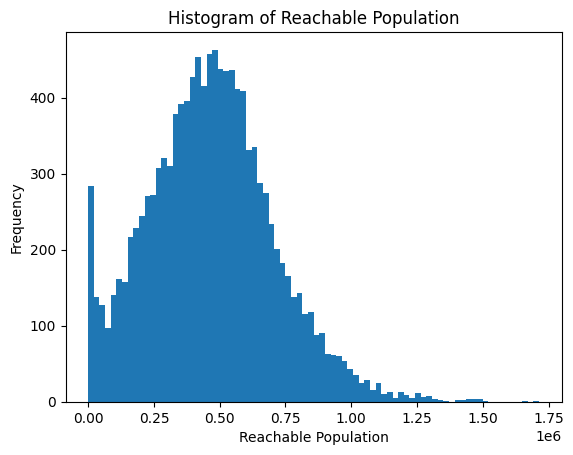

In [43]:
create_reachable_population_histogram(grid_df5, bins=80)

##Heatmap6: Walking 25 minutes

In [175]:
grid6=generate_grid_coordinates(140,120,200,get_coordinates("Berlin  Schadow-Haus"))

# Display the bounding box
display_grid_bbox(grid6)

Four closest grid points to the center:
Latitude: 52.517012405339734, Longitude: 13.382320428758923
Latitude: 52.517012405339734, Longitude: 13.384117059327162
Latitude: 52.5181056878592, Longitude: 13.382320428758923
Latitude: 52.5181056878592, Longitude: 13.384117059327162


center:52.51751089503317, 13.383218744043042


point calling function

In [176]:


# call the points for the wealking heatmap
grid_results6 = []
call_num=0

for point in grid6:
    call_num+=1
    print(f"{call_num}/{len(grid6)}")
    # Check if the result for this point is already cached
    cached_result = cache.get(point)

    if cached_result is not None:
        # Result is cached, use it
        if isinstance(cached_result, tuple):
          reachable_pop = cached_result[0]
        else:
          reachable_pop = cached_result
        print(f"cached result :{reachable_pop}")
    else:
        # Result is not cached, call the rate-limited function
        reachable_pop = rate_limited_pop_reachable(point, 1500)
        # Cache the result for future use
        cache.set(point, (reachable_pop))
        print(f"calc: {reachable_pop}")

    grid_results6.append({"latitude": point[0], "longitude": point[1], "reachable_population": reachable_pop})





Streaming output truncated to the last 5000 lines.
14301/16800
cached result :10944
14302/16800
cached result :10944
14303/16800
cached result :0
14304/16800
cached result :14758
14305/16800
cached result :656
14306/16800
cached result :9082
14307/16800
cached result :5413
14308/16800
cached result :1348
14309/16800
cached result :1300
14310/16800
cached result :1297
14311/16800
cached result :1813
14312/16800
cached result :1810
14313/16800
cached result :36007
14314/16800
cached result :36942
14315/16800
cached result :36413
14316/16800
cached result :37371
14317/16800
cached result :45380
14318/16800
cached result :52454
14319/16800
cached result :57936
14320/16800
cached result :60742
14321/16800
cached result :58870
14322/16800
cached result :58886
14323/16800
cached result :54432
14324/16800
cached result :58647
14325/16800
cached result :61139
14326/16800
cached result :57198
14327/16800
cached result :57967
14328/16800
cached result :61788
14329/16800
cached result :63738
14330

In [ ]:
grid_df6 = pd.DataFrame(grid_results6)

In [182]:
grid_df6 = pd.DataFrame(grid_results6)
print(grid_df6.head())
display_grid_on_map_with_intensity(grid_df6, 0.7)

    latitude  longitude  reachable_population
0  52.452461  13.258353                 20167
1  52.452461  13.260150                 20851
2  52.452461  13.261946                 21317
3  52.452461  13.263743                 21074
4  52.452461  13.265539                 20939
0.000547753222024383
(16800, 3)


##Combined Map

In [190]:
import pandas as pd
from scipy.spatial.distance import cdist

# Assuming grid_df4 and grid_df6 are defined

# Extract coordinates from both DataFrames
coords_df6 = grid_df6[['latitude', 'longitude']].values
coords_df4 = grid_df4[['latitude', 'longitude']].values

# Calculate distances between points in grid_df6 and grid_df4
distances = cdist(coords_df6, coords_df4)

# Find the index of the closest point in grid_df4 for each point in grid_df6
closest_indices = distances.argmin(axis=1)

# Extract the 'reachable_population' values (public_transport) from grid_df4
public_transport_values = grid_df4.loc[closest_indices, 'reachable_population'].values

# Add the 'public_transport' column to grid_df6
grid_df6['public_transport'] = public_transport_values

# Save the resulting DataFrame as "combined"
combined = grid_df6.copy()  # Create a copy to avoid modifying the original grid_df6
combined.to_csv("combined.csv", index=False)  # Save to CSV file

print("Combined DataFrame saved to combined.csv")

Combined DataFrame saved to combined.csv


In [191]:
grid_df6["ratio"]=grid_df6["reachable_population"]-grid_df6["public_transport"]


In [193]:
# Filter out invalid values from grid_df6
grid_df6_filtered = grid_df6[np.isfinite(grid_df6['ratio'])]

# Create and display the heatmap with the filtered DataFrame
display_grid_on_map_with_intensity2(grid_df6_filtered, 0.7, column_name="ratio", cutoff=-3)

    latitude  longitude  reachable_population  public_transport  ratio  \
0  52.452461  13.258353                 20167             17213   2954   
1  52.452461  13.260150                 20851             18948   1903   
2  52.452461  13.261946                 21317             21676   -359   
3  52.452461  13.263743                 21074             19370   1704   
4  52.452461  13.265539                 20939             19602   1337   

   normalized_population  
0               0.022303  
1              -0.010851  
2              -0.082206  
3              -0.017129  
4              -0.028706  
0.000547753222024383
(16527, 6)


(array([4.000e+00, 2.000e+00, 5.000e+00, 2.000e+00, 4.000e+00, 9.000e+00,
        1.300e+01, 1.500e+01, 1.700e+01, 2.400e+01, 3.000e+01, 4.700e+01,
        6.200e+01, 1.080e+02, 1.400e+02, 1.860e+02, 2.200e+02, 4.310e+02,
        6.210e+02, 9.790e+02, 1.823e+03, 3.320e+03, 3.603e+03, 2.431e+03,
        1.431e+03, 7.350e+02, 3.580e+02, 1.260e+02, 3.900e+01, 1.500e+01]),
 array([-245878.        , -234477.43333333, -223076.86666667,
        -211676.3       , -200275.73333333, -188875.16666667,
        -177474.6       , -166074.03333333, -154673.46666667,
        -143272.9       , -131872.33333333, -120471.76666667,
        -109071.2       ,  -97670.63333333,  -86270.06666667,
         -74869.5       ,  -63468.93333333,  -52068.36666667,
         -40667.8       ,  -29267.23333333,  -17866.66666667,
          -6466.1       ,    4934.46666667,   16335.03333333,
          27735.6       ,   39136.16666667,   50536.73333333,
          61937.3       ,   73337.86666667,   84738.43333333,
        

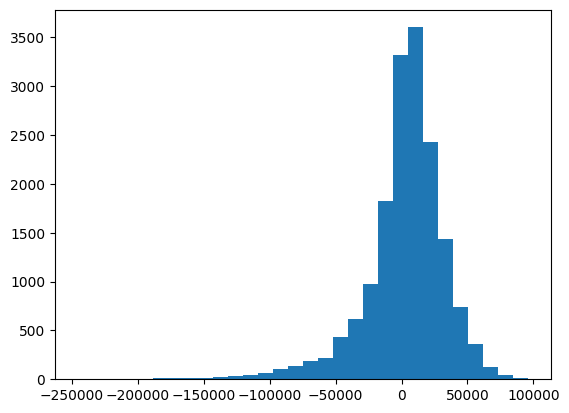

In [187]:
plt.hist(grid_df6_filtered["ratio"], bins=30)

(array([4.000e+00, 2.000e+00, 5.000e+00, 2.000e+00, 4.000e+00, 9.000e+00,
        1.300e+01, 1.500e+01, 1.700e+01, 2.400e+01, 3.000e+01, 4.700e+01,
        6.200e+01, 1.080e+02, 1.400e+02, 1.860e+02, 2.200e+02, 4.310e+02,
        6.210e+02, 9.790e+02, 1.823e+03, 3.320e+03, 3.603e+03, 2.431e+03,
        1.431e+03, 7.350e+02, 3.580e+02, 1.260e+02, 3.900e+01, 1.500e+01]),
 array([-7.82710312, -7.46747222, -7.10784133, -6.74821044, -6.38857955,
        -6.02894865, -5.66931776, -5.30968687, -4.95005598, -4.59042508,
        -4.23079419, -3.8711633 , -3.51153241, -3.15190151, -2.79227062,
        -2.43263973, -2.07300884, -1.71337794, -1.35374705, -0.99411616,
        -0.63448527, -0.27485437,  0.08477652,  0.44440741,  0.8040383 ,
         1.16366919,  1.52330009,  1.88293098,  2.24256187,  2.60219276,
         2.96182366]),
 <BarContainer object of 30 artists>)

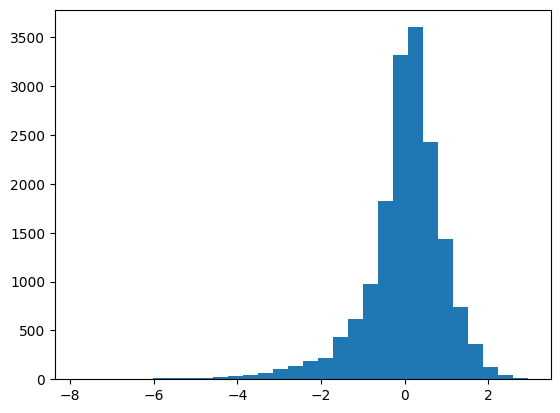

In [153]:
plt.hist(grid_df6_filtered["normalized_population"], bins=30)

#debugging


In [178]:
filtered_grid_df6 = grid_df6[grid_df6['reachable_population'] == 0]


In [179]:
filtered_grid_df6

,latitude,longitude,reachable_population
90,52.452461,13.420050,0
91,52.452461,13.421846,0
92,52.452461,13.423643,0
93,52.452461,13.425440,0
94,52.452461,13.427236,0
...,...,...,...
14154,52.562907,13.283506,0
14156,52.562907,13.287099,0
14161,52.562907,13.296082,0
14162,52.562907,13.297879,0


In [180]:
# Get the points from filtered_grid_df6
filtered_points = filtered_grid_df6[['latitude', 'longitude']].values.tolist()

# Create a dictionary to store the new reachable_population values
new_reachable_pop_values = {}
call_num = 0

for point in filtered_points:
    call_num += 1
    print(f"{call_num}/{len(filtered_points)}")

    # Directly call the rate-limited function without cache check
    reachable_pop = rate_limited_pop_reachable(point, 1500)

    # Store the new value in the dictionary
    new_reachable_pop_values[tuple(point)] = reachable_pop

# Update grid_results6 with the new values
for i in range(len(grid_results6)):
    point_tuple = (grid_results6[i]['latitude'], grid_results6[i]['longitude'])
    if point_tuple in new_reachable_pop_values:
        grid_results6[i]['reachable_population'] = new_reachable_pop_values[point_tuple]

# ... (rest of your code) ...

1/160
2/160
3/160
4/160
5/160
6/160
7/160
8/160
9/160
10/160
11/160
12/160
13/160
14/160
15/160
16/160
17/160
18/160
19/160
20/160
21/160
22/160
23/160
24/160
25/160
26/160
27/160
28/160
29/160
30/160
31/160
32/160
33/160
34/160
35/160
36/160
37/160
38/160
39/160
40/160
41/160
42/160
43/160
44/160
45/160
46/160
47/160
48/160
49/160
50/160
51/160
52/160
53/160
54/160
55/160
56/160
57/160
58/160
59/160
60/160
61/160
62/160
63/160
64/160
65/160
66/160
67/160
68/160
69/160
70/160
71/160
72/160
73/160
74/160
75/160
76/160
77/160
78/160
79/160
80/160
81/160
82/160
83/160
84/160
85/160
86/160
87/160
88/160
89/160
90/160
91/160
92/160
93/160
94/160
95/160
96/160
97/160
98/160
99/160
100/160
101/160
102/160
103/160
104/160
105/160
106/160
107/160
108/160
109/160
110/160
111/160
112/160
113/160
114/160
115/160
116/160
117/160
118/160
119/160
120/160
121/160
122/160
123/160
124/160
125/160
126/160
127/160
128/160
129/160
130/160
131/160
132/160
133/160
134/160
135/160
136/160
137/160
138/160
139/